<a href="https://colab.research.google.com/github/remysealswarchild/predictive-analytics/blob/main/VisualSlam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab: 3D Scene Understanding & SLAM with Deep Learning

This notebook implements key concepts from the lecture on 3D Scene Understanding and SLAM (Simultaneous Localization and Mapping), aligning with Lecture 7.

We'll cover:
1.  **Environment Setup**
2.  **Monocular Depth Estimation** (using Deep Learning - MiDaS via PyTorch Hub)
3.  **Visual SLAM Components & Implementation** (Feature-based approach with ORB)
4.  **3D Object Detection** (using Deep Learning - Detectron2)
5.  **Integration and Visualization** (SLAM Map & Trajectory with Matplotlib)

We use pre-trained models and classical CV techniques to demonstrate concepts without extensive training. This version is adapted for Google Colab compatibility, emphasizing Matplotlib for visualizations.

In [2]:
# Install Detectron2
# The following command installs Detectron2 from the official GitHub repository.
!pip install git+https://github.com/facebookresearch/detectron2.git --quiet
# If the above fails, check the official guide: https://detectron2.readthedocs.io/en/latest/tutorials/install.html

# Install Open3D
!pip install open3d --quiet

# Import necessary libraries
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
# import torchvision.transforms as tv_transforms # Removed as it's not directly used (MiDaS has its own transforms)
from PIL import Image
import open3d as o3d
import requests
from io import BytesIO
import gdown
from tqdm.notebook import tqdm # For progress bar

# Ensure Matplotlib plots are displayed inline in notebooks
%matplotlib inline

# Detectron2 specific imports (place after installation)
try:
    import detectron2
    from detectron2.engine import DefaultPredictor
    from detectron2.config import get_cfg
    from detectron2 import model_zoo
    from detectron2.utils.visualizer import Visualizer
    from detectron2.data import MetadataCatalog
    print("Detectron2 imported successfully.")
    detectron2_available = True
except ImportError:
    print("Detectron2 not found or installation failed. Object detection section will be skipped.")
    detectron2_available = False

# Set device for torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.3/81.3 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 447.7/447.7 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 111.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 74.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 62.0 MB/s eta 0:00:00
Detectron2 imported successfully.
Using device: cpu


Loaded image with shape: (1080, 1529, 3)


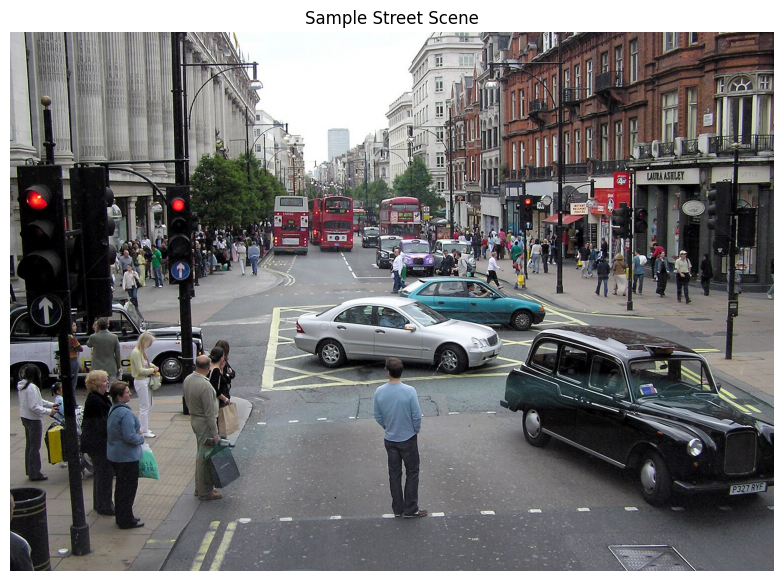

In [4]:
# Function to load image from URL
def load_image_from_url(url):
    try:
        headers = {'User-Agent': 'Mozilla/5.0' } # Using a common user-agent
        response = requests.get(url, headers=headers)
        response.raise_for_status() # Raise an exception for bad status codes
        img = Image.open(BytesIO(response.content)).convert('RGB')
        return np.array(img) # Return as numpy array
    except requests.exceptions.RequestException as e:
        print(f"Error fetching image: {e}")
        return None

# Sample street scene image URL
street_img_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/f/f1/Oxford.street.london.arp.jpg/1529px-Oxford.street.london.arp.jpg"

img = load_image_from_url(street_img_url)

if img is not None:
    print(f"Loaded image with shape: {img.shape}")
    plt.figure(figsize=(10, 7))
    plt.imshow(img)
    plt.title("Sample Street Scene")
    plt.axis('off')
    plt.show()
else:
    print("Failed to load sample image. Please check the URL or network connection.")

In [5]:
# Set device for torch (already done, but good to be explicit where model is loaded)
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(f"Using device: {device}") # Redundant if already printed

midas_ready = False
transform = None
midas = None
model_type = "DPT_Large" # Defaulting to DPT_Large for high quality

try:
    # Using DPT_Large as a reliable high-quality option from MiDaS.
    print(f"Attempting to load MiDaS model: {model_type} from PyTorch Hub...")
    # trust_repo=True is needed for loading from GitHub repos not part of the default PyTorch Hub
    midas = torch.hub.load("intel-isl/MiDaS", model_type, trust_repo=True)
    midas.to(device)
    midas.eval() # Set model to evaluation mode
    print(f"Successfully loaded MiDaS model type: {model_type}")

    # Load appropriate transforms based on model type
    print("Loading MiDaS transforms...")
    midas_transforms_hub = torch.hub.load("intel-isl/MiDaS", "transforms", trust_repo=True)

    # Select the correct transform function based on the loaded model type
    if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
        transform = midas_transforms_hub.dpt_transform
    elif model_type == "MiDaS_small":
        transform = midas_transforms_hub.small_transform
    else:
        # Fallback or if new models are added with a generic transform pattern
        print(f"Warning: Model type {model_type} not explicitly handled for transforms, attempting default DPT transform.")
        transform = midas_transforms_hub.dpt_transform # Defaulting to DPT if unsure

    if transform:
         transform_name = getattr(transform, '__name__', str(type(transform)))
         print(f"Selected transform function: {transform_name}")
         midas_ready = True
    else:
         print(f"Error: Could not determine the correct MiDaS transform for {model_type}.")
         midas_ready = False

except Exception as e:
    print(f"ERROR loading MiDaS model or transforms: {e}")
    print("Troubleshooting tips:")
    print(f"- Check the model name ('{model_type}') is correct and available on PyTorch Hub for 'intel-isl/MiDaS'.")
    print("- Ensure you have a stable internet connection to download model weights.")
    print("- Verify required libraries are installed: torch, torchvision (and potentially 'timm').")
    print("- Check for compatibility issues with your PyTorch version.")
    midas_ready = False

if midas_ready:
    print("\nMiDaS model and transforms ready for use.")
else:
    print("\nMiDaS model or transforms failed to load. Depth estimation cannot proceed.")

Attempting to load MiDaS model: DPT_Large from PyTorch Hub...


Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
Downloading: "https://github.com/isl-org/MiDaS/releases/download/v3/dpt_large_384.pt" to /root/.cache/torch/hub/checkpoints/dpt_large_384.pt
100%|██████████| 1.28G/1.28G [00:21<00:00, 64.9MB/s]


Successfully loaded MiDaS model type: DPT_Large
Loading MiDaS transforms...
Selected transform function: <class 'torchvision.transforms.transforms.Compose'>

MiDaS model and transforms ready for use.


Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


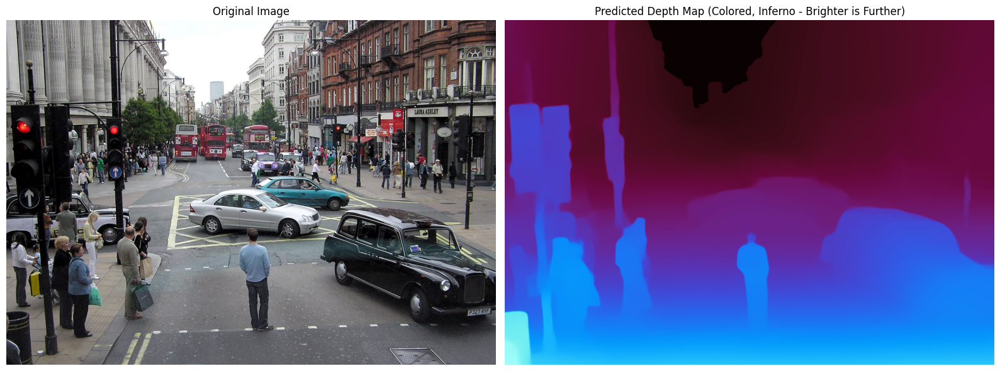

In [6]:
# Function to predict depth map
def predict_depth(img_input, midas_model, transform_func):
    if img_input is None or not midas_ready:
        print("Input image or MiDaS model not ready.")
        return None

    # Transform input for model
    # Important: MiDaS expects RGB input
    input_batch = transform_func(img_input).to(device)

    # Make prediction
    with torch.no_grad():
        prediction = midas_model(input_batch)

        # Resize prediction to original image size using bicubic interpolation for smoother results
        prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=img_input.shape[:2], # Original height, width
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    # Convert to numpy array
    depth_map = prediction.cpu().numpy()

    # MiDaS produces relative inverse depth. Larger values = closer.
    # We return the raw map; inversion/scaling handled later if needed for specific applications like point clouds.
    return depth_map

# Predict depth for our sample image
if img is not None and midas_ready:
    depth_map = predict_depth(img, midas, transform)

    if depth_map is not None:
        # Visualize original image and depth map side by side
        # MiDaS output: larger values = closer. For visualization (brighter=further), we can invert.
        # Normalizing for visualization:
        depth_viz_normalized = cv2.normalize(depth_map, None, 255, 0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U) # Inverted: 0 means furthest, 255 closest
        depth_viz_colored = cv2.applyColorMap(depth_viz_normalized, cv2.COLORMAP_INFERNO) # Inferno: Brighter=further (after our normalization)

        plt.figure(figsize=(16, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img)
        plt.title("Original Image")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(depth_viz_colored)
        plt.title("Predicted Depth Map (Colored, Inferno - Brighter is Further)")
        plt.axis("off")

        plt.tight_layout()
        plt.show()
    else:
        print("Depth prediction failed.")
else:
    print("Cannot predict depth - image or MiDaS model not loaded.")

Creating point cloud data for Matplotlib...
0.0 37.47987
Generated 1651320 points.
Subsampled point cloud from 1651320 to 15012 for interactive Matplotlib.


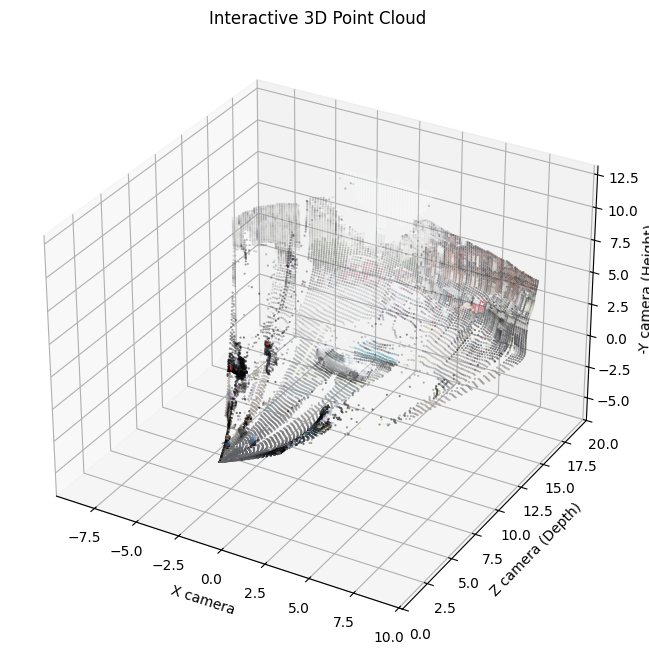

interactive(children=(FloatSlider(value=20.0, description='Elevation:', max=90.0, min=-90.0, step=5.0), FloatS…

In [10]:
# Ensure these are imported if not already at the top of your notebook
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # For 3D plotting
import cv2 # For image operations if needed by other parts
# %matplotlib inline # Usually good to have at the start of the notebook

# Import ipywidgets for interactive controls
from ipywidgets import interactive, FloatSlider
from IPython.display import display

# --- Modified function to return points and colors for Matplotlib ---
def create_point_cloud_for_matplotlib(rgb_image, depth_map_midas, camera_intrinsics=None, depth_display_scale=10.0):
    """
    Creates 3D points and colors from an RGB image and a MiDaS depth map,
    suitable for Matplotlib visualization.

    Args:
        rgb_image (np.array): The RGB image (H, W, 3).
        depth_map_midas (np.array): The depth map from MiDaS (H, W). Assumes relative inverse depth.
        camera_intrinsics (dict): Optional. Dictionary with 'fx', 'fy', 'cx', 'cy'.
                                 If None, uses assumed values.
        depth_display_scale (float): Arbitrary scaling factor for visual appearance of depth.

    Returns:
        tuple: (points_cam_flat, colors_flat)
               points_cam_flat (np.array): Nx3 array of 3D point coordinates.
               colors_flat (np.array): Nx3 array of RGB colors (0-1 range).
    """
    height, width = depth_map_midas.shape
    rgb_np = rgb_image

    # --- Camera Intrinsics ---
    if camera_intrinsics:
        fx = camera_intrinsics['fx']
        fy = camera_intrinsics['fy']
        cx = camera_intrinsics['cx']
        cy = camera_intrinsics['cy']
    else:
        # **ASSUMED INTRINSICS** - Replace with actual values if known!
        fx = 0.9 * width  # Adjusted rough estimate
        fy = 0.9 * width  # Adjusted rough estimate (assuming square pixels)
        cx = width / 2.0
        cy = height / 2.0
        print("Warning: Using assumed camera intrinsics for point cloud generation!")

    # --- Handle MiDaS Depth ---
    # MiDaS output is relative inverse depth (larger value = closer).
    # To get relative depth (larger value = further), we invert.
    relative_depth = depth_map_midas # Add epsilon

    # Normalize the relative depth robustly for better scaling (0-1 range)
    depth_min_percentile = np.percentile(relative_depth, 2)
    depth_max_percentile = np.percentile(relative_depth, 98)
    print(depth_min_percentile, depth_max_percentile) # Debugging output
    relative_depth_clipped = np.clip(relative_depth, depth_min_percentile, depth_max_percentile)

    # Check for valid range after clipping
    if (depth_max_percentile - depth_min_percentile) <= 1e-8: # Avoid division by zero if range is too small
        print("Warning: Depth range is very small, normalization might be unstable. Setting z_normalized to zeros.")
        z_normalized = np.zeros_like(relative_depth_clipped)
    else:
        z_normalized = (relative_depth_clipped - depth_min_percentile) * 1.0 / (depth_max_percentile - depth_min_percentile)

    z_scaled = (1- z_normalized) * depth_display_scale
    # print(f"Note: Applied arbitrary depth display scaling factor: {depth_display_scale}") # Can be verbose

    # Create meshgrid for pixel coordinates (u, v)
    u_coords, v_coords = np.meshgrid(np.arange(width), np.arange(height))

    # Back-project pixels to 3D points (Camera Coordinate System: X right, Y down, Z forward)
    x_cam = (u_coords - cx) * z_scaled / fx
    y_cam = (v_coords - cy) * z_scaled / fy # Y is typically downwards in image coords, this maintains it
    # z_cam is z_scaled

    points_cam = np.stack((x_cam, y_cam, z_scaled), axis=-1)
    points_cam_flat = points_cam.reshape(-1, 3)
    colors_flat = rgb_np.reshape(-1, 3) / 255.0

    return points_cam_flat, colors_flat

# --- Create and Visualize Point Cloud with Interactive Matplotlib ---
if 'img' in locals() and img is not None and \
   'depth_map' in locals() and depth_map is not None:

    print("Creating point cloud data for Matplotlib...")
    # Use a display scale that makes sense for visualization.
    # This scales the "depth" dimension of the point cloud.
    points_3d, point_colors = create_point_cloud_for_matplotlib(img, depth_map, depth_display_scale=20.0)
    print(f"Generated {points_3d.shape[0]} points.")

    if points_3d.shape[0] > 0:
        # Subsample for interactive Matplotlib performance
        # Adjust num_points_interactive_mpl for more/less detail vs. responsiveness
        num_points_interactive_mpl = 15000  # Target number of points
        if points_3d.shape[0] > num_points_interactive_mpl:
            step = points_3d.shape[0] // num_points_interactive_mpl
            points_sub = points_3d[::step]
            colors_sub = point_colors[::step]
            print(f"Subsampled point cloud from {points_3d.shape[0]} to {points_sub.shape[0]} for interactive Matplotlib.")
        else:
            points_sub = points_3d
            colors_sub = point_colors

        # Create the figure and 3D axis ONCE
        fig_interactive = plt.figure(figsize=(10, 8))
        ax_interactive = fig_interactive.add_subplot(111, projection='3d')

        # Store the scatter plot object to update its data or properties if needed,
        # but for view_init, we just re-call it on the axis.
        scatter_plot = ax_interactive.scatter(
            points_sub[:, 0], points_sub[:, 2], -points_sub[:, 1], # X, Z, -Y for a more intuitive "upright" view
            c=colors_sub, s=1, marker='.', depthshade=True
        )

        ax_interactive.set_xlabel("X camera")
        ax_interactive.set_ylabel("Z camera (Depth)") # Corresponds to original Z
        ax_interactive.set_zlabel("-Y camera (Height)") # Corresponds to inverted original Y for "up"
        ax_interactive.set_title("Interactive 3D Point Cloud")

        # Set initial limits based on data
        # (Plot X, Z, -Y)
        x_coords, z_coords, neg_y_coords = points_sub[:, 0], points_sub[:, 2], -points_sub[:, 1]

        max_range = np.array([x_coords.max()-x_coords.min(),
                              z_coords.max()-z_coords.min(),
                              neg_y_coords.max()-neg_y_coords.min()]).max() / 2.0
        if max_range < 1e-6: max_range = 5.0 # Default if very small

        mid_x = (x_coords.max()+x_coords.min()) * 0.5
        mid_z = (z_coords.max()+z_coords.min()) * 0.5
        mid_neg_y = (neg_y_coords.max()+neg_y_coords.min()) * 0.5

        ax_interactive.set_xlim(mid_x - max_range, mid_x + max_range)
        ax_interactive.set_ylim(mid_z - max_range, mid_z + max_range) # Plotting Z on Y-axis of plot
        ax_interactive.set_zlim(mid_neg_y - max_range, mid_neg_y + max_range) # Plotting -Y on Z-axis of plot

        # Function to update the plot view
        def update_view(elev=20, azim=-75):
            ax_interactive.view_init(elev=elev, azim=azim)
            # fig_interactive.canvas.draw_idle() # Not always needed with `interactive` widget
            display(fig_interactive) # Re-display the figure to show updates in some environments

        # Create sliders
        elev_slider = FloatSlider(min=-90, max=90, step=5, value=20, description='Elevation:')
        azim_slider = FloatSlider(min=-180, max=180, step=10, value=-75, description='Azimuth:')

        # Create interactive widget
        # Note: The plot might re-appear below sliders each time in classic Jupyter.
        # In JupyterLab, the behavior might be better with output widgets.
        # For Colab, this should generally work.
        interactive_plot = interactive(update_view, elev=elev_slider, azim=azim_slider)
        display(interactive_plot)

        # Initial display of the plot before interaction (optional, as `interactive` will call it)
        # update_view(elev_slider.value, azim_slider.value)
        # plt.show() # Not needed if using display(fig) inside update_view

    else:
        print("Point cloud is empty or could not be generated.")
else:
    print("Cannot create point cloud - image or depth map not available or 'img'/'depth_map' variables are not defined.")

In [12]:
# Download a sample video (e.g., from a driving sequence)
def download_sample_video(file_id="project_video.mp4", output="sample_driving.mp4"):
    print(f"Downloading sample video to {output}...")
    # Using a direct link to a smaller video for faster download in Colab
    # This is a common test video for vehicle detection / tracking examples
    url = f"https://github.com/JunshengFu/vehicle-detection/blob/master/examples/{file_id}?raw=true"
    # Alternative smaller video if the above is too large or slow:
    # url = " https://media.githubusercontent.com/media/intel-isl/MiDaS/master/ τέλος " # Placeholder, find a real small video if needed
    try:
      # Using gdown which is robust for large files from Google Drive, but also works for general URLs
      gdown.download(url, output, quiet=False, fuzzy=True) # fuzzy=True can help with direct GitHub links
      print(f"Downloaded sample video to {output}")
      if os.path.exists(output) and os.path.getsize(output) > 0:
          return output
      else:
          print(f"Error: Downloaded file {output} is empty or does not exist.")
          print("Attempting a more direct requests download...")
          response = requests.get(url, stream=True)
          response.raise_for_status()
          with open(output, 'wb') as f:
              for chunk in response.iter_content(chunk_size=8192):
                  f.write(chunk)
          print(f"Downloaded sample video to {output} using requests.")
          if os.path.exists(output) and os.path.getsize(output) > 0:
             return output
          else:
             print(f"Error: Fallback download also failed for {output}.")
             return None
    except Exception as e:
      print(f"Failed to download video: {e}")
      print("Please ensure gdown is installed, the link is accessible, or try an alternative video URL.")
      return None

video_path = download_sample_video()
if video_path:
    print(f"Video ready at: {video_path}")
else:
    print("Video download failed. SLAM section might not run correctly.")

Downloading...
From: https://github.com/JunshengFu/vehicle-detection/blob/master/examples/project_video.mp4?raw=true
To: /content/sample_driving.mp4
100%|██████████| 25.3M/25.3M [00:00<00:00, 170MB/s]

Downloaded sample video to sample_driving.mp4
Video ready at: sample_driving.mp4


In [19]:
# Simple Visual SLAM implementation using ORB features
class SimpleVisualSLAM:
    def __init__(self, camera_intrinsics):
        # Initialize ORB detector and Brute-Force Matcher
        self.orb = cv2.ORB_create(nfeatures=2000) # Increased features for potentially better tracking
        self.bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) # Use crossCheck for better initial matches

        # --- Camera Intrinsic Parameters ---
        # MUST be calibrated for the specific camera/video used!
        self.K = camera_intrinsics
        self.fx = self.K[0, 0]
        self.fy = self.K[1, 1]
        self.cx = self.K[0, 2]
        self.cy = self.K[1, 2]
        print(f"SLAM Initialized with K:\n{self.K}")

        # Trajectory storage (world coordinates, starting at origin)
        self.trajectory = [np.array([0.0, 0.0, 0.0])]
        self.current_pose = np.eye(4)  # Initial pose (T_world_camera)

        # Store previous frame info
        self.prev_frame_gray = None
        self.prev_kp = None
        self.prev_des = None
        self.prev_color_frame = None # For coloring map points

        # Map points storage (world coordinates)
        self.map_points = []
        self.map_colors = []

    def detect_features(self, frame_gray):
        """Detect ORB features in the grayscale frame"""
        kp, des = self.orb.detectAndCompute(frame_gray, None)
        return kp, des

    def match_features(self, des1, des2):
        """Match features between two frames using Hamming distance and cross-check"""
        if des1 is None or des2 is None or len(des1) < 10 or len(des2) < 10:
            return []

        matches = self.bf.match(des1, des2)
        matches = sorted(matches, key=lambda x: x.distance)
        # Consider keeping a fixed number of top matches or a percentage
        # good_matches = matches[:min(len(matches), 100)] # Example: keep top 100
        return matches

    def estimate_motion(self, kp1, kp2, matches):
        """Estimate relative camera motion (pose T_current_previous) between frames"""
        min_matches_for_pose = 10 # Minimum matches for findEssentialMat (robustness)
        if len(matches) < min_matches_for_pose:
            # print("Warning: Not enough matches for pose estimation.") # Can be verbose
            return None, [] # Indicate failure, return empty inlier_matches

        pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])
        pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])

        E, mask_E = cv2.findEssentialMat(pts2, pts1, self.K, method=cv2.RANSAC,
                                         prob=0.999, threshold=1.0) # Robust threshold

        if E is None or mask_E is None or np.sum(mask_E) < min_matches_for_pose:
            # print("Warning: Failed to estimate Essential Matrix or not enough inliers.") # Can be verbose
            return None, []

        # Recover relative Rotation (R) and translation (t)
        # T_current_previous: pose of current frame wrt previous frame
        inlier_count, R, t, mask_Rp = cv2.recoverPose(E, pts2, pts1, self.K, mask=mask_E)

        if inlier_count < min_matches_for_pose:
             # print("Warning: Failed to recover pose or not enough inliers after recoverPose.") # Can be verbose
             return None, []

        transform_matrix = np.eye(4)
        transform_matrix[:3, :3] = R
        transform_matrix[:3, 3] = t.flatten()

        # Combine masks: only use points that were inliers for E and also for recoverPose
        # mask_Rp is applied to the points that were already filtered by mask_E
        # So, effectively, we need to find indices from original 'matches' that satisfy both
        combined_mask_indices = [i for i, (e_inlier, rp_inlier) in enumerate(zip(mask_E.flatten(), mask_Rp.flatten())) if e_inlier and rp_inlier]
        inlier_matches = [matches[i] for i in combined_mask_indices]

        return transform_matrix, inlier_matches

    def triangulate_points(self, kp1, kp2, inlier_matches, T_world_prev, T_world_curr):
        """Triangulate 3D points from matched features using world poses."""
        if not inlier_matches or self.prev_color_frame is None:
            return np.array([]), []

        pts1_norm = cv2.undistortPoints(np.float32([kp1[m.queryIdx].pt for m in inlier_matches]).reshape(-1,1,2), self.K, None)
        pts2_norm = cv2.undistortPoints(np.float32([kp2[m.trainIdx].pt for m in inlier_matches]).reshape(-1,1,2), self.K, None)

        # Projection matrices P = K[R|t] from world to camera
        # For triangulation, we need P1 = K @ inv(T_world_prev)[:3,:] and P2 = K @ inv(T_world_curr)[:3,:]
        # Or, more directly, P1 = K @ [I|0] for prev cam coords, P2 = K @ T_curr_prev[:3,:]
        # Let's use the world poses for clarity with T_world_camera format.
        P1 = self.K @ np.linalg.inv(T_world_prev)[:3, :] # Projection from world to prev_cam frame
        P2 = self.K @ np.linalg.inv(T_world_curr)[:3, :] # Projection from world to curr_cam frame

        # Triangulate points in world coordinates
        points_4d_hom = cv2.triangulatePoints(P1, P2, pts1_norm, pts2_norm)
        points_3d_world = (points_4d_hom / points_4d_hom[3]).T[:, :3] # Convert from homogeneous to 3D world coords

        # Filter points based on positive depth in *both* camera frames and reprojection error (simplified here)
        # Check positive depth in previous camera frame
        points_3d_prev_cam = (np.linalg.inv(T_world_prev) @ np.vstack((points_3d_world.T, np.ones((1, points_3d_world.shape[0])))))[:3].T
        # Check positive depth in current camera frame
        points_3d_curr_cam = (np.linalg.inv(T_world_curr) @ np.vstack((points_3d_world.T, np.ones((1, points_3d_world.shape[0])))))[:3].T

        depth_threshold_min = 0.1 # Min distance in front of camera
        depth_threshold_max = 100.0 # Max distance (scene dependent)

        final_points_3d_world = []
        final_colors = []

        for i, m in enumerate(inlier_matches):
            pt_world = points_3d_world[i]
            pt_prev_cam = points_3d_prev_cam[i]
            pt_curr_cam = points_3d_curr_cam[i]

            if (depth_threshold_min < pt_prev_cam[2] < depth_threshold_max and
                depth_threshold_min < pt_curr_cam[2] < depth_threshold_max):
                u, v = kp1[m.queryIdx].pt
                if 0 <= int(v) < self.prev_color_frame.shape[0] and 0 <= int(u) < self.prev_color_frame.shape[1]:
                    color = self.prev_color_frame[int(v), int(u)][::-1] / 255.0 # BGR to RGB, normalize
                    final_points_3d_world.append(pt_world)
                    final_colors.append(color)

        return np.array(final_points_3d_world), np.array(final_colors)

    def process_frame(self, frame):
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        kp_curr, des_curr = self.detect_features(frame_gray)

        result_frame = frame.copy()
        num_matches = 0
        num_inliers = 0

        if self.prev_frame_gray is not None and self.prev_kp is not None and self.prev_des is not None and len(kp_curr) > 10:
            matches = self.match_features(self.prev_des, des_curr)
            num_matches = len(matches)

            if num_matches >= 10: # Use a threshold consistent with estimate_motion
                T_curr_prev, inlier_matches = self.estimate_motion(self.prev_kp, kp_curr, matches)
                num_inliers = len(inlier_matches)

                if T_curr_prev is not None and num_inliers > 0:
                    T_world_prev = self.current_pose.copy() # Pose of the previous frame
                    self.current_pose = self.current_pose @ T_curr_prev # Update: T_w_curr = T_w_prev @ T_prev_curr
                    self.trajectory.append(self.current_pose[:3, 3].copy())

                    # Triangulate new map points
                    if num_inliers > 5: # Need enough inliers for triangulation
                        new_points_3d_world, new_point_colors = self.triangulate_points(
                            self.prev_kp, kp_curr, inlier_matches,
                            T_world_prev, self.current_pose
                        )
                        if new_points_3d_world.shape[0] > 0:
                             self.map_points.extend(new_points_3d_world)
                             self.map_colors.extend(new_point_colors)

                    # Draw inlier matches for visualization (top 50)
                    result_frame = cv2.drawMatches(self.prev_color_frame, self.prev_kp, frame, kp_curr,
                                                   inlier_matches[:min(len(inlier_matches), 50)], None,
                                                   matchColor=(0, 255, 0), singlePointColor=None,
                                                   flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        # Update previous frame info
        self.prev_frame_gray = frame_gray
        self.prev_kp = kp_curr
        self.prev_des = des_curr
        self.prev_color_frame = frame.copy()

        pos = self.current_pose[:3, 3]
        text_pose = f"Pose: ({pos[0]:.2f}, {pos[1]:.2f}, {pos[2]:.2f})"
        text_matches = f"Matches: {num_matches} | Inliers: {num_inliers}"
        text_map = f"Map Points: {len(self.map_points)}"
        cv2.putText(result_frame, text_pose, (20, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
        cv2.putText(result_frame, text_matches, (20, 60), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
        cv2.putText(result_frame, text_map, (20, 90), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

        return result_frame

    def get_point_cloud(self):
        if not self.map_points:
            # print("Map is empty.") # Can be verbose
            return None

        pcd = o3d.geometry.PointCloud()
        points_np = np.array(self.map_points)
        colors_np = np.array(self.map_colors)

        if points_np.shape[0] == 0 or colors_np.shape[0] == 0 or points_np.shape[0] != colors_np.shape[0]:
            # print(f"Warning: Mismatch or empty points/colors. Pts: {points_np.shape}, Clrs: {colors_np.shape}")
            return None

        pcd.points = o3d.utility.Vector3dVector(points_np)
        pcd.colors = o3d.utility.Vector3dVector(colors_np)

        if len(pcd.points) > 100: # Only apply outlier removal if enough points
            try:
                 # print(f"Point cloud size before outlier removal: {len(pcd.points)}")
                 pcd_filtered, _ = pcd.remove_statistical_outlier(nb_neighbors=20, std_ratio=2.0)
                 if len(pcd_filtered.points) > 0:
                     pcd = pcd_filtered
                 # print(f"Point cloud size after outlier removal: {len(pcd.points)}")
            except Exception as e:
                 print(f"Could not perform point cloud outlier removal: {e}")

        return pcd

    def get_trajectory(self):
        return np.array(self.trajectory)


Starting SLAM processing...
Processing video: sample_driving.mp4
Input video: sample_driving.mp4 (1280x720 @ 25.00 FPS)
Will process up to 500 frames.
SLAM Initialized with K:
[[718.856    0.     607.1928]
 [  0.     718.856  185.2157]
 [  0.       0.       1.    ]]
Output video will be saved to: slam_output_half_size.mp4 with dims (1280x360)


Processing SLAM:   0%|          | 0/500 [00:00<?, ?it/s]


SLAM processing complete. Output video saved as 'slam_output_half_size.mp4'.

--- Sample Processed Frames (Matplotlib) ---


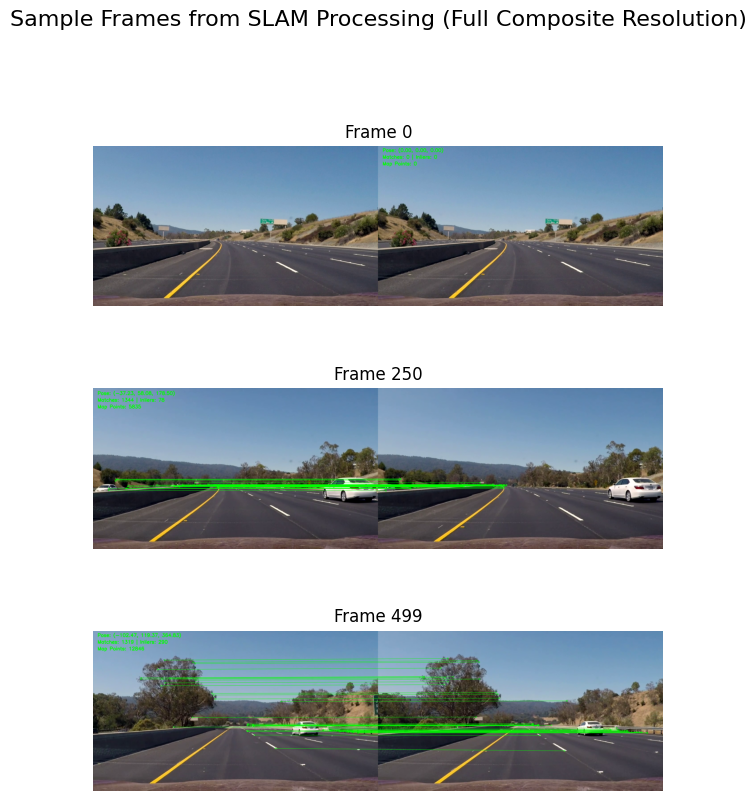


--- Estimated Trajectory (Matplotlib) ---


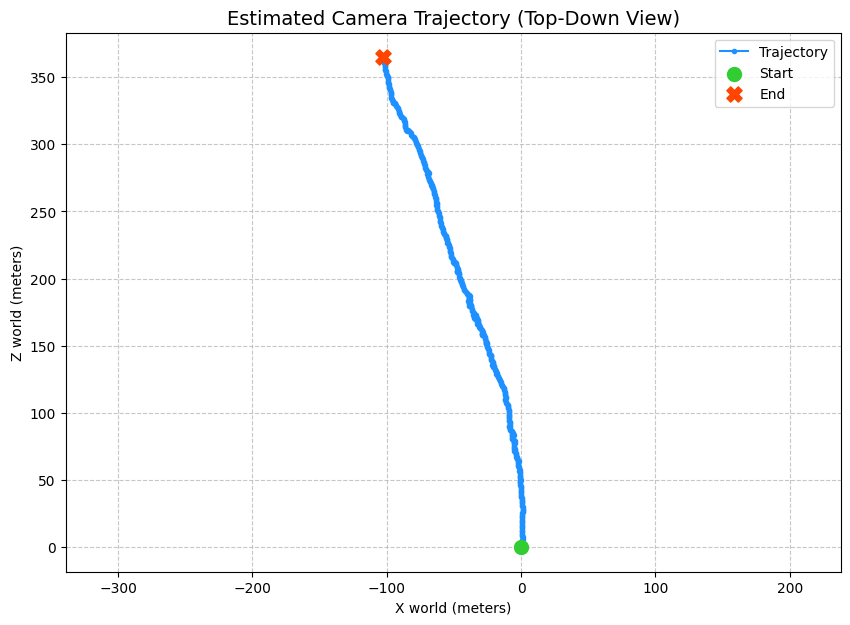

In [25]:
def process_video_slam(video_path, camera_intrinsics, max_frames_to_process=150):
    if video_path is None or not os.path.exists(video_path):
        print(f"Error: Video file not found at {video_path}")
        return None
    print(f"Processing video: {video_path}")
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return None

    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    input_frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    input_frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    output_fps = min(fps if fps > 0 else 15, 15)

    num_frames_to_run = min(max_frames_to_process, total_frames) if max_frames_to_process is not None else total_frames
    if num_frames_to_run <= 0:
         print("Error: No frames to process.")
         cap.release()
         return None
    print(f"Input video: {video_path} ({input_frame_width}x{input_frame_height} @ {fps:.2f} FPS)")
    print(f"Will process up to {num_frames_to_run} frames.")

    slam = SimpleVisualSLAM(camera_intrinsics)

    output_video_path = 'slam_output_half_size.mp4'
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')

    composite_frame_width = input_frame_width * 2
    composite_frame_height = input_frame_height

    final_output_video_width = composite_frame_width // 2
    final_output_video_height = composite_frame_height // 2

    video_writer = cv2.VideoWriter(output_video_path, fourcc, output_fps,
                                   (final_output_video_width, final_output_video_height))
    print(f"Output video will be saved to: {output_video_path} with dims ({final_output_video_width}x{final_output_video_height})")

    first_frame_display, middle_frame_display, last_frame_display = None, None, None
    last_processed_frame_idx = 0

    for frame_idx in tqdm(range(num_frames_to_run), desc="Processing SLAM"):
        ret, frame = cap.read()
        if not ret:
            print("\nReached end of video or error reading frame.")
            break
        last_processed_frame_idx = frame_idx
        processed_frame_output = slam.process_frame(frame)

        final_video_frame_full_res = np.zeros((composite_frame_height, composite_frame_width, 3), dtype=np.uint8)

        if processed_frame_output.shape[1] == composite_frame_width:
            final_video_frame_full_res = processed_frame_output
        elif processed_frame_output.shape[1] == input_frame_width:
            final_video_frame_full_res[:, :input_frame_width] = frame
            final_video_frame_full_res[:, input_frame_width:] = processed_frame_output
        else:
            print(f"Warning: Unexpected SLAM output frame shape {processed_frame_output.shape}. Resizing/padding to composite size.")
            resized_fallback = cv2.resize(processed_frame_output, (composite_frame_width, composite_frame_height))
            final_video_frame_full_res = resized_fallback

        frame_to_write = cv2.resize(final_video_frame_full_res,
                                    (final_output_video_width, final_output_video_height),
                                    interpolation=cv2.INTER_AREA)
        video_writer.write(frame_to_write)

        if frame_idx == 0: first_frame_display = final_video_frame_full_res.copy()
        if frame_idx == num_frames_to_run // 2: middle_frame_display = final_video_frame_full_res.copy()
        if frame_idx == num_frames_to_run - 1: last_frame_display = final_video_frame_full_res.copy()

    if last_frame_display is None and last_processed_frame_idx > 0 and 'final_video_frame_full_res' in locals():
        last_frame_display = final_video_frame_full_res.copy()

    cap.release()
    video_writer.release()
    print(f"\nSLAM processing complete. Output video saved as '{output_video_path}'.")

    print("\n--- Sample Processed Frames (Matplotlib) ---")
    fig_frames, axs_frames = plt.subplots(3, 1, figsize=(6, 9))
    fig_frames.suptitle('Sample Frames from SLAM Processing (Full Composite Resolution)', fontsize=16)
    titles = [f"Frame 0", f"Frame {num_frames_to_run // 2}", f"Frame {last_processed_frame_idx}"]
    frames_to_show = [first_frame_display, middle_frame_display, last_frame_display]
    for i, (ax, frame_data, title) in enumerate(zip(axs_frames, frames_to_show, titles)):
        ax.set_title(title)
        if frame_data is not None:
            ax.imshow(cv2.cvtColor(frame_data, cv2.COLOR_BGR2RGB))
            ax.axis('off')
        else:
            ax.text(0.5, 0.5, 'Frame not captured', ha='center', va='center', transform=ax.transAxes)
            ax.axis('off')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    print("\n--- Estimated Trajectory (Matplotlib) ---")
    trajectory = slam.get_trajectory()
    if trajectory is not None and trajectory.shape[0] > 1:
        plt.figure(figsize=(10, 7))
        plt.plot(trajectory[:, 0], trajectory[:, 2], marker='.', linestyle='-', color='dodgerblue', label='Trajectory')
        plt.scatter(trajectory[0, 0], trajectory[0, 2], marker='o', color='limegreen', s=100, label='Start', zorder=5)
        plt.scatter(trajectory[-1, 0], trajectory[-1, 2], marker='X', color='orangered', s=120, label='End', zorder=5)
        plt.title("Estimated Camera Trajectory (Top-Down View)", fontsize=14)
        plt.xlabel("X world (meters)")
        plt.ylabel("Z world (meters)")
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend()
        plt.axis('equal')
        plt.show()
    else:
        print("Not enough trajectory data to plot or trajectory is None.")

    return slam

# --- IMPORTANT: Define Camera Intrinsics ---
kitti_intrinsics = np.array([
    [718.8560,   0.    , 607.1928],
    [  0.    , 718.8560, 185.2157],
    [  0.    ,   0.    ,   1.    ]
])

# --- Run the SLAM process on the downloaded video ---
slam_system = None # Initialize to None
if 'video_path' in locals() and video_path is not None and os.path.exists(video_path):
     # Imports for display are now within the function or at the top of the cell
     # Ensure matplotlib is available for the plots inside process_video_slam
     print("Starting SLAM processing...")
     # Reduced max_frames for faster Colab execution, e.g., 250 frames
     slam_system = process_video_slam(video_path, kitti_intrinsics, max_frames_to_process=500)
else:
     print("Skipping SLAM processing: 'video_path' is not defined, video download failed, or file does not exist.")

In [26]:
from google.colab import output
output.enable_custom_widget_manager()

Support for third party widgets will remain active for the duration of the session. To disable support:

In [27]:
from google.colab import output
output.disable_custom_widget_manager()

In [31]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('slam_output_half_size.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(
    """
    <video width=640 controls>
        <source src="%s" type="video/mp4">
    </video>
    """ % data_url
)